### Supervised Learning Notebook
1. Regression Model Exploration
2. Evaluation
3. Feature Importance
4. Ablation Analysis 
5. Sensitivity Analysis
6. Failure Analysis

In [3]:
#ML Imports
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, cross_val_score, learning_curve
from sklearn.linear_model import LinearRegression, LogisticRegression, Ridge
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, accuracy_score, f1_score, roc_auc_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
import xgboost as xgb #conda install -c conda-forge py-xgboost
import geopandas as gpd #conda install geopandas
from sklearn.preprocessing import OneHotEncoder
import ast
from sklearn.pipeline import Pipeline
from sklearn.svm import SVR, SVC, LinearSVR
from xgboost import XGBRegressor, XGBClassifier
from sklearn.compose import ColumnTransformer
import shap
from sklearn.model_selection import GridSearchCV, KFold
from scipy.stats import randint

In [4]:
df = pd.read_csv("FinalFeaturesDF.csv") #(116012, 178)

In [5]:
#df1=df.copy()
pd.set_option('display.max_columns', None)

1. Regression Model Exploration

In [6]:
# Define target and features
regression_target = 'demand_score'
#regression_target2 = 'ADOPTION_DEMAND_SCORE'
#regression_target3 ='EV_PENETRATION'

classification_target = 'high_demand'
y_clf = df[classification_target].astype(int)
feature_columns	= [
        ###targets###
        'EV_PENETRATION', 'EV_GROWTH_RATE', 'EV_PER_STATION','EV_INFRASTRUCTURE_INDEX', 'LOG_EV_REG', 'ADOPTION_DEMAND_SCORE',
        #'sessions_per_port', 
    'avg_charge_time',# 'demand_score', 'high_demand', 'low_demand'
        
        ###strings###
        #'STATION_NAME', 'CITY',
        
        ###strings one hot encoded###
        #'EV_CONNECTOR_TYPES','EV_PRICING','FACILITY_TYPE', 'EV_NETWORK', 'Month', 'STATE_NAME','STATE','season',' record_count',
    
        'LATITUDE', 'LONGITUDE',
        'POPULATION', 'MEDIAN_INCOME',
    
        'EV_LEVEL1_EVSE_NUM', 'EV_LEVEL2_EVSE_CNUM', 'EV_DC_FAST_NUM',
    
        'ELECTRIC_VEHICLE_REG_COUNT', 'PLUG_IN_HYBRID_VEHICLE_REG_COUNT','HYBRID_ELECTRIC_REG_COUNT',
    
        'TOTAL_DURATION',
        'CHARGE_DURATION','ENERGY_KWH', 'NUM_PORTS', 'TOTAL_SESSIONS',
    
        'CTYPE_J1772', 'CTYPE_CHAdeMO', 'CTYPE_Combo',
    
        'EV_NETWORK_AMPUP','EV_NETWORK_Blink Network', 'EV_NETWORK_ChargePoint Network','EV_NETWORK_EV Connect', 'EV_NETWORK_Electrify America','EV_NETWORK_FLO', 'EV_NETWORK_LOOP', 'EV_NETWORK_Non-Networked',
        'EV_NETWORK_Other', 'EV_NETWORK_RED_E', 'EV_NETWORK_SHELL_RECHARGE','EV_NETWORK_SWTCH', 'EV_NETWORK_Tesla', 'EV_NETWORK_Tesla Destination',
        'EV_NETWORK_VIALYNK', 'EV_NETWORK_eVgo Network', 'PRICE_per_kwh_rate','PRICE_per_minute_rate', 'PRICE_per_hour_rate', 'PRICE_per_session_fee',
        
        'PRICE_monthly_fee', 'PRICE_activation_fee_present','PRICE_parking_fee_present', 'PRICE_is_free', 'PRICE_other_or_unknown',
        'FACILITY_TYPE_HOTEL', 'FACILITY_TYPE_CAR_DEALER','FACILITY_TYPE_PARKING_LOT', 'FACILITY_TYPE_OFFICE_BLDG','FACILITY_TYPE_PUBLIC', 'FACILITY_TYPE_PARKING_GARAGE',
        'FACILITY_TYPE_MULTI_UNIT_DWELLING', 'FACILITY_TYPE_MUNI_GOV','FACILITY_TYPE_COLLEGE_CAMPUS',
        'FACILITY_TYPE_SHOPPING_CENTER', 'FACILITY_TYPE_FED_GOV','FACILITY_TYPE_RESTAURANT', 'FACILITY_TYPE_GAS_STATION','FACILITY_TYPE_HOSPITAL', 'FACILITY_TYPE_UTILITY','FACILITY_TYPE_STREET_PARKING', 'FACILITY_TYPE_GROCERY',
        'FACILITY_TYPE_INN', 'FACILITY_TYPE_BREWERY_DISTILLERY_WINERY', 'FACILITY_TYPE_BREWERY_DISTILLERY_WINERY.1',
        'FACILITY_TYPE_CAR_DEALER.1', 'FACILITY_TYPE_COLLEGE_CAMPUS.1','FACILITY_TYPE_FED_GOV.1', 'FACILITY_TYPE_GAS_STATION.1',
        'FACILITY_TYPE_GROCERY.1', 'FACILITY_TYPE_HOSPITAL.1','FACILITY_TYPE_HOTEL.1', 'FACILITY_TYPE_INN.1','FACILITY_TYPE_MULTI_UNIT_DWELLING.1', 'FACILITY_TYPE_MUNI_GOV.1',
        'FACILITY_TYPE_OFFICE_BLDG.1', 'FACILITY_TYPE_OTHER.1','FACILITY_TYPE_PARKING_GARAGE.1',
        'FACILITY_TYPE_PARKING_LOT.1', 'FACILITY_TYPE_PUBLIC.1','FACILITY_TYPE_RESTAURANT.1', 'FACILITY_TYPE_SHOPPING_CENTER.1',
        'FACILITY_TYPE_STREET_PARKING.1', 'FACILITY_TYPE_UTILITY.1',
        'STATE_AK', 'STATE_AL', 'STATE_AR', 'STATE_AZ','STATE_CO', 'STATE_CT', 'STATE_DC', 'STATE_DE', 'STATE_FL', 'STATE_GA','STATE_HI', 'STATE_IA', 'STATE_ID', 'STATE_IL', 'STATE_IN', 'STATE_KS',
        'STATE_KY', 'STATE_LA', 'STATE_MA', 'STATE_MD', 'STATE_ME', 'STATE_MI','STATE_MN', 'STATE_MO', 'STATE_MS', 'STATE_MT', 'STATE_NC', 'STATE_ND',
        'STATE_NE', 'STATE_NH', 'STATE_NJ', 'STATE_NM', 'STATE_NV', 'STATE_NY','STATE_OH', 'STATE_OK', 'STATE_OR', 'STATE_PA', 'STATE_RI', 'STATE_SC',
        'STATE_SD', 'STATE_TN', 'STATE_TX', 'STATE_UT', 'STATE_VA', 'STATE_VT','STATE_WA', 'STATE_WI', 'STATE_WV', 'STATE_WY',
        
        'record_count_1', 'record_count_2', 'record_count_3', 'record_count_4',
        
        'season_fall','season_spring', 'season_summer', 'season_winter',
        'Month_1.0','Month_2.0', 'Month_3.0', 'Month_4.0', 'Month_5.0', 'Month_6.0',
        'Month_7.0', 'Month_8.0', 'Month_9.0', 'Month_10.0', 'Month_11.0','Month_12.0',
        ]

X = df[feature_columns]

y_reg1= df[regression_target]
#y_reg2= df[regression_target2]
#y_reg3= df[regression_target3]

y_clf= df[classification_target]

In [7]:
#data split 
X_train, X_test, y_train, y_test=train_test_split(X, y_reg1, test_size=0.2, random_state=42)
#X_train_reg2, X_test_reg2, y_train_reg2, y_test_reg2=train_test_split(X, y_reg2, test_size=0.2, random_state=42)
#X_train_reg3, X_test_reg3, y_train_reg3, y_test_reg3=train_test_split(X, y_reg3, test_size=0.2, random_state=42)
#X_train_clf, X_test_clf, y_train_clf, y_test_clf= train_test_split(X, y_clf, test_size=0.2, random_state=42)

In [7]:
# Regresssion Pipelines

# Ridge Regression Pipeline
ridgereg_pipeline = Pipeline(steps=[
    ('scaler', StandardScaler()),
    ('regressor', Ridge(random_state=42))
])

# Random Forest Regressor Pipeline
rfreg_pipeline = Pipeline(steps=[
    ('regressor', RandomForestRegressor(
        n_estimators=200, #default = 100
        max_depth=20, #default = None
        min_samples_leaf=5, #default = 1
        n_jobs= -1, #default = None
        random_state=42))])

#XGBoost Regressor
xgb_pipeline = Pipeline(steps=[
    ('regressor', XGBRegressor(
        n_estimators=100,      # default 100     # more trees = better performance up to a point
        learning_rate=0.1,     # default 0.3     # lower = more conservative boosting
        max_depth=6,           # default 6       # controls model complexity; deeper = more overfitting risk
        subsample=1.0,         # default 1.0     # fraction of samples used per tree; <1 adds randomness
        colsample_bytree=1.0,  # default 1.0     # fraction of features used per tree
        random_state=42,
        verbosity=0            # suppresses training messages
    ))])

#Evaluate

def evaluate_regression(model, X_test, y_test, name="Model"):
    y_pred = model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)  
    #rmse = mean_squared_error(y_test, y_pred)#, squared=False)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    return {"Model": name, "RMSE": rmse, "MAE": mae, "R2": r2}

In [8]:
#Regression: Demand Score

ridgereg_pipeline.fit(X_train, y_train)
rfreg_pipeline.fit(X_train, y_train)
xgb_pipeline.fit(X_train, y_train)

# Evaluate regression models
regression_results = [
    evaluate_regression(ridgereg_pipeline, X_test, y_test, "Ridge Regression"),
    evaluate_regression(rfreg_pipeline, X_test, y_test, "Random Forest Regressor"),
    evaluate_regression(xgb_pipeline, X_test, y_test, "XGBoost Regressor"),
]

regression_results_df = pd.DataFrame(regression_results)
regression_results_df

,Model,RMSE,MAE,R2
0,Ridge Regression,262.964712,117.547585,0.777387
1,Random Forest Regressor,20.333687,0.466902,0.998669
2,XGBoost Regressor,12.972001,1.725861,0.999458


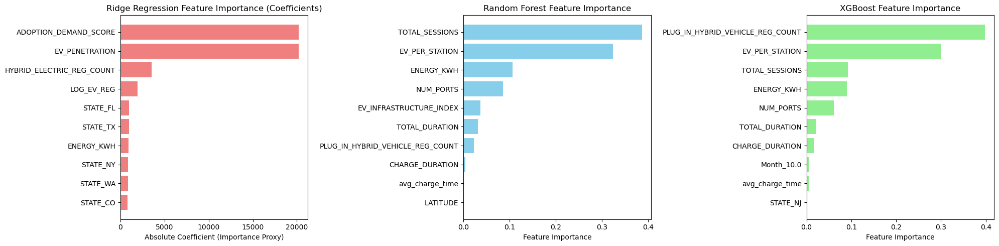

In [9]:
feature_names = X_train.columns

# Ridge Regression (coefficients as importance proxy)
ridge_coef = ridgereg_pipeline.named_steps['regressor'].coef_
ridge_importance_df = pd.DataFrame({
    'feature': feature_names,
    'importance': np.abs(ridge_coef) 
}).sort_values('importance', ascending=False).head(10)

# Random Forest
rf_importances = rfreg_pipeline.named_steps['regressor'].feature_importances_
rf_importance_df = pd.DataFrame({
    'feature': feature_names,
    'importance': rf_importances
}).sort_values('importance', ascending=False).head(10)

# XGBoost
xgb_importances = xgb_pipeline.named_steps['regressor'].feature_importances_
xgb_importance_df = pd.DataFrame({
    'feature': feature_names,
    'importance': xgb_importances
}).sort_values('importance', ascending=False).head(10)

fig, axes = plt.subplots(1, 3, figsize=(20, 5))

# Ridge Regression
axes[0].barh(ridge_importance_df['feature'], ridge_importance_df['importance'], color='lightcoral')
axes[0].set_xlabel('Absolute Coefficient (Importance Proxy)')
axes[0].set_title('Ridge Regression Feature Importance (Coefficients)')
axes[0].invert_yaxis()

# Random Forest
axes[1].barh(rf_importance_df['feature'], rf_importance_df['importance'], color='skyblue')
axes[1].set_xlabel('Feature Importance')
axes[1].set_title('Random Forest Feature Importance')
axes[1].invert_yaxis()

# XGBoost
axes[2].barh(xgb_importance_df['feature'], xgb_importance_df['importance'], color='lightgreen')
axes[2].set_xlabel('Feature Importance')
axes[2].set_title('XGBoost Feature Importance')
axes[2].invert_yaxis()

plt.tight_layout()
plt.show()

2. Evaluation

Hyperparameter Tuning with 10 fold CV

In [11]:
#scoring metric Negative MSE (since GridSearchCV maximizes the score)
scoring = 'neg_mean_squared_error'

# cv strategy 10 fold
#cv = KFold(n_splits=10, shuffle=True, random_state=42)
cv = KFold(n_splits=5, shuffle=True, random_state=42)

#parameters for grid for hyperparameter tuning
param_grid = {
    'regressor__n_estimators': [100, 200, 300],  # Varying the number of trees
    'regressor__max_depth': [10, 20, 30],#, None],  # Different tree depths
    'regressor__min_samples_leaf': [1, 5, 10],  # Number of samples required at leaf node
    'regressor__max_features': ['auto', 'sqrt', 'log2'],  # Maximum number of features
}

#girdsearch with 10 fold CV and scoring as negative MSE
grid_search = GridSearchCV(
    estimator=rfreg_pipeline,
    param_grid=param_grid,
    cv=cv,
    scoring=scoring,
    n_jobs=1,  # Use all processors
    verbose=1,  # Verbose to get feedback during fitting
)

grid_search.fit(X_train, y_train)

best_param=grid_search.best_params_
best_score_negMSE= grid_search.best_score_

results = grid_search.cv_results_

#results (sorted by mean test score)
result_df=pd.DataFrame(results).sort_values(by='mean_test_score', ascending=False)

Fitting 5 folds for each of 81 candidates, totalling 405 fits


In [14]:
print (best_param)

{'regressor__max_depth': 30, 'regressor__max_features': 'sqrt', 'regressor__min_samples_leaf': 1, 'regressor__n_estimators': 300}


In [13]:
BestRFG = Pipeline(steps=[
    ('regressor', RandomForestRegressor(
        n_estimators=best_param['regressor__n_estimators'],
        max_depth=best_param['regressor__max_depth'],
        min_samples_leaf=best_param['regressor__min_samples_leaf'],
        max_features=best_param['regressor__max_features'],
        n_jobs=-1,
        random_state=42))
])

BestRFG.fit(X_train, y_train) 
results = evaluate_regression(BestRFG, X_test, y_test, "RF")
results

{'Model': 'RF',
 'RMSE': np.float64(11.26090756492948),
 'MAE': 1.7883843570012223,
 'R2': 0.9995917724903628}

In [8]:
BestRFG = Pipeline(steps=[
    ('regressor', RandomForestRegressor(
        n_estimators=300,
        max_depth=30,
        min_samples_leaf=1,
        max_features='sqrt',
        n_jobs=-1,
        random_state=42))
])

BestRFG.fit(X_train, y_train) 
results = evaluate_regression(BestRFG, X_test, y_test, "RF")
results

NameError: name 'evaluate_regression' is not defined

3. Feature Importance

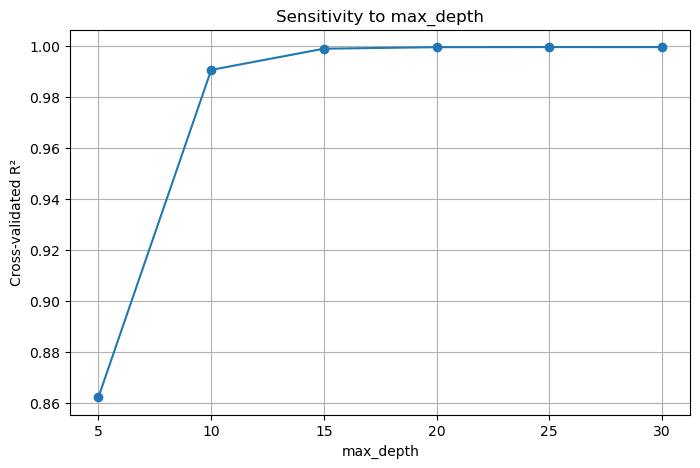

In [54]:
#From our hyperparameter tuning, we found by far the two most important hyperparameters were
###learning_rate and depth. 

# Define the range of values
max_depth_range = [5, 10, 15, 20, 25, 30]  # None = no max depth
scores = []

for depth in max_depth_range:
    model = Pipeline(steps=[
        ('regressor', RandomForestRegressor(
            n_estimators=best_param['regressor__n_estimators'],
            max_depth=depth,
            min_samples_leaf=best_param['regressor__min_samples_leaf'],
            max_features=best_param['regressor__max_features'],
            n_jobs=-1,
            random_state=42))
    ])
    
    # Cross-validation (use your actual X and y)
    cv_score = cross_val_score(model, X_train, y_train, cv=5, scoring='r2', n_jobs=-1)
    scores.append(np.mean(cv_score))

# Plot
plt.figure(figsize=(8, 5))
depth_labels = [str(d) for d in max_depth_range]
plt.plot(depth_labels, scores, marker='o')
plt.title("Sensitivity to max_depth")
plt.xlabel("max_depth")
plt.ylabel("Cross-validated R²")
plt.grid(True)
plt.show()


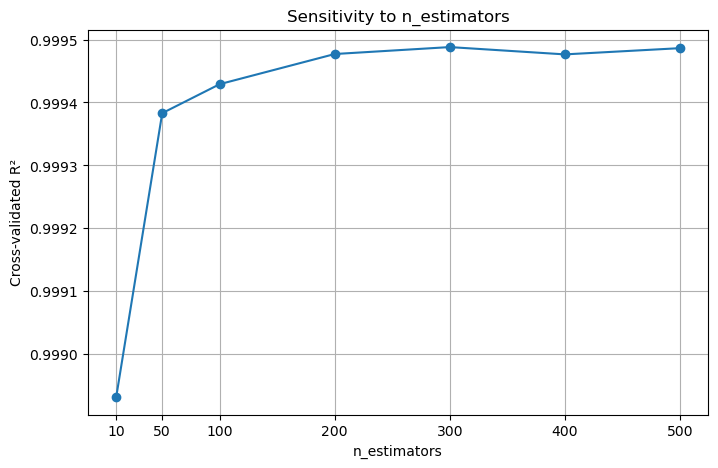

In [60]:
#From our hyperparameter tuning, we found by far the two most important hyperparameters were
###n_estimators_range. 
###min_samples_leaf

# Define the range of values
n_estimators_range = [10, 50, 100, 200, 300, 400, 500]
#min_samples_leaf_range = [1, 2, 5, 10, 20]
scores = []

for n_est in n_estimators_range:
    model = Pipeline(steps=[
        ('regressor', RandomForestRegressor(
            n_estimators=n_est,
            max_depth=best_param['regressor__max_depth'],
            min_samples_leaf=best_param['regressor__min_samples_leaf'],
            max_features=best_param['regressor__max_features'],
            n_jobs=-1,
            random_state=42
        ))
    ])
    
    # Cross-validation (use your actual X and y)
    cv_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='r2', n_jobs=-1)
    scores.append(np.mean(cv_scores))

# Plot 
plt.figure(figsize=(8, 5))
plt.plot(n_estimators_range, scores, marker='o')
plt.title("Sensitivity to n_estimators")
plt.xlabel("n_estimators")
plt.ylabel("Cross-validated R²")
plt.grid(True)
plt.xticks(n_estimators_range)  #
plt.show()


In [69]:
import time
import psutil  # optional for memory

complexity_settings = [
    {"n_estimators": 10, "max_depth": 5},
    {"n_estimators": 100, "max_depth": 10},
    {"n_estimators": 500, "max_depth": 20},
]

speed_results = []
for params in complexity_settings:
    rf = RandomForestRegressor(
        n_estimators=params["n_estimators"],
        max_depth=params["max_depth"],
        n_jobs=-1,
        random_state=42
    )
    
    # Training time
    t0 = time.time()
    rf.fit(X_train, y_train)
    train_time = time.time() - t0
    
    # Inference time (on 1000 samples)
    X_sample = X_test.iloc[:1000]
    t0 = time.time()
    _ = rf.predict(X_sample)
    pred_time = time.time() - t0
    
    # Accuracy
    r2 = r2_score(y_test, rf.predict(X_test))
    
    speed_results.append({
        "n_estimators": params["n_estimators"],
        "max_depth": params["max_depth"],
        "Train Time (s)": round(train_time, 2),
        "Pred Time (ms)": round(pred_time * 1000, 2),
        "R²": round(r2, 3)
    })

pd.DataFrame(speed_results)

,n_estimators,max_depth,Train Time (s),Pred Time (ms),R²
0,10,5,0.94,15.19,0.991
1,100,10,13.31,14.74,0.999
2,500,20,88.38,83.07,0.999


In [ ]:
#Local Interpretability (Single Prediction): explains one prediction
instance_index = 42  # row number of interest
shap.plots.waterfall(shap_values[instance_index])
#waterfall plot breaking down how much each feature increased or decreased the predicted demand
#Why is the demand high for this specific station?

In [ ]:
#EXplore how affects prediction
#shap.plots.scatter(shap_values[:, "TOTAL_SESSIONS"], color=shap_values)

4. Abolation Analysis

In [16]:
ablation_results = []
top_features = [
    'TOTAL_SESSIONS','EV_PER_STATION', 'ENERGY_KWH', 'NUM_PORTS', 
    'EV_INFRASTRUCTURE_INDEX', 'TOTAL_DURATION','PLUG_IN_HYBRID_VEHICLE_REG_COUNT','CHARGE_DURATION','avg_charge_time', 
]

numeric_features = feature_columns 
categorical_features = []

for feature in top_features:
    if feature in numeric_features:
        reduced_num = [f for f in numeric_features if f != feature]
        reduced_cat = categorical_features.copy()
    elif feature in categorical_features:
        reduced_num = numeric_features.copy()
        reduced_cat = [f for f in categorical_features if f != feature]
    else:
        raise ValueError(f"Feature '{feature}' not found in numeric or categorical lists.")

    #reduced datasets
    X_train_ab = X_train.drop(columns=[feature])
    X_test_ab = X_test.drop(columns=[feature])

    #pipeline with updated feature lists
    rf_pipeline_ablation = Pipeline(steps=[
        ('preprocessor', ColumnTransformer([
            ('num', StandardScaler(), reduced_num),
            ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
        ], remainder='drop')),
        ('regressor', RandomForestRegressor(random_state=42))
    ])
    
    rf_pipeline_ablation.fit(X_train_ab, y_train)
    y_pred_ab = rf_pipeline_ablation.predict(X_test_ab)
    rmse_ab = np.sqrt(mean_squared_error(y_test, y_pred_ab))
    
    ablation_results.append({
        "Removed Feature": feature,
        "RMSE": rmse_ab
    })

ablation_df = pd.DataFrame(ablation_results).sort_values("RMSE", ascending=False)
#print("\nAblation Analysis (Higher RMSE = More Important Feature):")
ablation_df

,Removed Feature,RMSE
7,CHARGE_DURATION,19.072631
3,NUM_PORTS,18.929158
8,avg_charge_time,17.901981
6,PLUG_IN_HYBRID_VEHICLE_REG_COUNT,17.850643
4,EV_INFRASTRUCTURE_INDEX,17.788679
1,EV_PER_STATION,17.745035
5,TOTAL_DURATION,16.442242
2,ENERGY_KWH,12.331348
0,TOTAL_SESSIONS,6.746068


5. Sensitivity Analysis

100%|===================| 92795/92809 [37:46<00:00]        

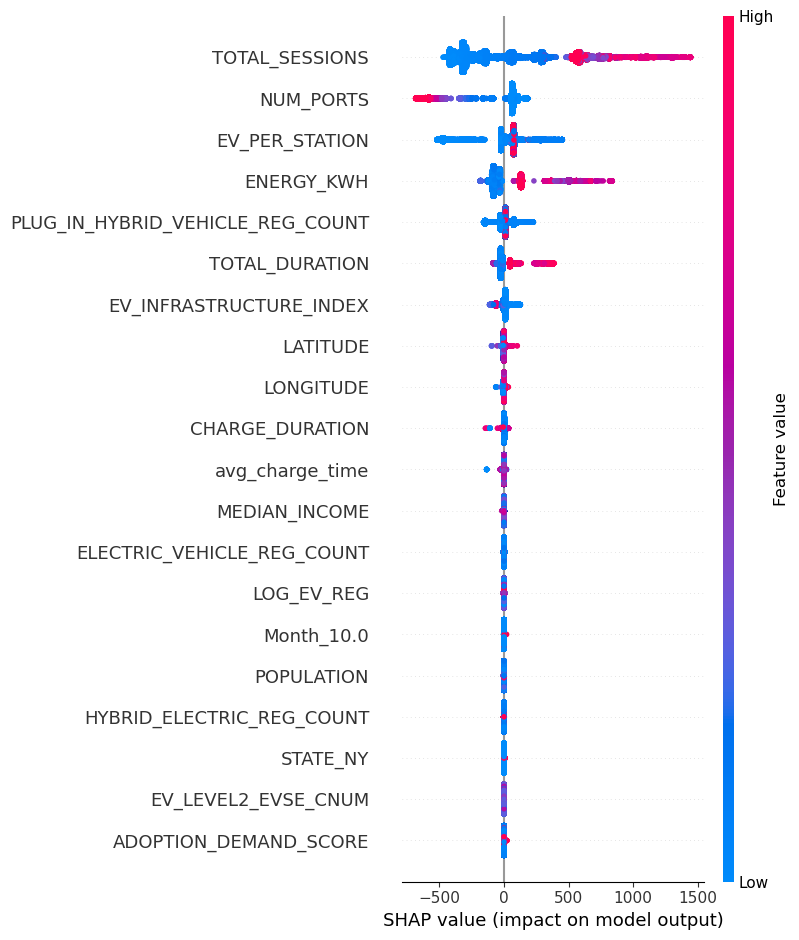

In [15]:
#Shap
rf_model= RandomForestRegressor(
        n_estimators=200, #default = 100
        max_depth=20, #default = None
        min_samples_leaf=5, #default = 1
        n_jobs= -1, #default = None
        random_state=42)


rf_model.fit(X_train, y_train)

explainer = shap.Explainer(rf_model, X_train)
shap_values = explainer(X_train)

shap.summary_plot(shap_values, X_train)


Learning Curve Analysis

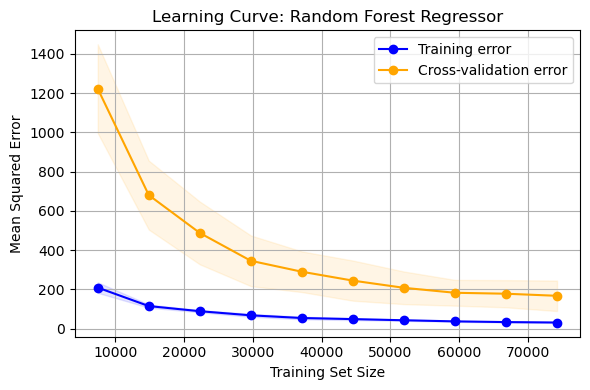

In [59]:
#generate learning curves
train_sizes, train_scores, val_scores = learning_curve(
    estimator=BestRFG,
    X=X_train,
    y=y_train,
    train_sizes=np.linspace(0.1, 1.0, 10),  # 10 points from 10% to 100% of data
    cv=5,  # 5-fold cross-validation
    scoring='neg_mean_squared_error',  # or 'r2'
    n_jobs=-1,
    shuffle=True,
    random_state=42
)

# mean and std
train_scores_mean = -np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
val_scores_mean = -np.mean(val_scores, axis=1)
val_scores_std = np.std(val_scores, axis=1)

# Plot
plt.figure(figsize=(6, 4))
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training error')
plt.plot(train_sizes, val_scores_mean, 'o-', color='orange', label='Cross-validation error')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.1, color='blue')
plt.fill_between(train_sizes, val_scores_mean - val_scores_std,
                 val_scores_mean + val_scores_std, alpha=0.1, color='orange')

plt.title("Learning Curve: Random Forest Regressor")
plt.xlabel("Training Set Size")
plt.ylabel("Mean Squared Error")
plt.legend(loc="best")
plt.grid(True)
plt.tight_layout()
plt.show()

6. Failure Analysis

In [64]:
#2. Failure Case Inspection (Random Forest)
y_pred = rfreg_pipeline.predict(X_test)
residuals = y_test - y_pred
abs_errors = np.abs(residuals)

failures_df = X_test.copy()
failures_df["Actual"] = y_test
failures_df["Predicted"] = y_pred
failures_df["Error"] = residuals
failures_df["AbsError"] = abs_errors

top_failures = failures_df.sort_values("AbsError", ascending=False).head(3)
print(top_failures[['Actual', 'Predicted', 'Error']])


           Actual    Predicted        Error
11727  341.920000  2275.953419 -1934.033419
11720  399.181818  2290.074671 -1890.892853
11737  815.100000  2214.730246 -1399.630246


In [68]:
# Split data
X_train, X_test, y_train, y_test = train_test_split(
    X, df[regression_target], test_size=0.2, random_state=42
)

# Train Random Forest Regressor
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# Predict
y_pred = rf.predict(X_test)

# Compute errors
errors = np.abs(y_pred - y_test.values)
test_df = X_test.copy()
test_df['Actual'] = y_test.values
test_df['Predicted'] = y_pred
test_df['Error'] = errors

# Sort by error to find worst predictions
worst_predictions = test_df.sort_values('Error', ascending=False).head(10)

example_indices = worst_predictions.index[:3]  # Top 3 worst

# Example 1: Extreme Outlier in Target
idx1 = example_indices[0]
print(f"Example 1 (Index {idx1}):")
print(f"  Actual: ${y_test.loc[idx1]:.2f}k, Predicted: ${y_pred[idx1]:.2f}k, Error: ${errors[idx1]:.2f}k")
print("  Features:", X_test.loc[idx1].to_dict())

# Example 2: Rare Feature Combination (Underrepresented Region)
idx2 = example_indices[1]
print(f"Example 2 (Index {idx2}):")
print(f"  Actual: ${y_test.loc[idx2]:.2f}k, Predicted: ${y_pred[idx2]:.2f}k, Error: ${errors[idx2]:.2f}k")
print("  Features:", X_test.loc[idx2].to_dict())


# Example 3: Nonlinear Interaction Not Captured
idx3 = example_indices[2]
print(f"Example 3 (Index {idx3}):")
print(f"  Actual: ${y_test.loc[idx3]:.2f}k, Predicted: ${y_pred[idx3]:.2f}k, Error: ${errors[idx3]:.2f}k")
print("  Features:", X_test.loc[idx3].to_dict())


=== FAILURE ANALYSIS: 3 Specific Examples ===

Example 1 (Index 11727):
  Actual: $341.92k, Predicted: $381.47k, Error: $0.00k
  Features: {'EV_PENETRATION': 0.4747551222956795, 'EV_GROWTH_RATE': 0.0, 'EV_PER_STATION': 36144.0, 'EV_INFRASTRUCTURE_INDEX': 0.0276671093404161, 'LOG_EV_REG': 13.714143170259746, 'ADOPTION_DEMAND_SCORE': 0.4319931114386001, 'avg_charge_time': 2.2514018548848336, 'LATITUDE': 34.05903, 'LONGITUDE': -118.41293, 'POPULATION': 1903297.0, 'MEDIAN_INCOME': 102285.0, 'EV_LEVEL1_EVSE_NUM': 0.0, 'EV_LEVEL2_EVSE_CNUM': 1.0, 'EV_DC_FAST_NUM': 0.0, 'ELECTRIC_VEHICLE_REG_COUNT': 903600.0, 'PLUG_IN_HYBRID_VEHICLE_REG_COUNT': 361100.0, 'HYBRID_ELECTRIC_REG_COUNT': 1514000.0, 'TOTAL_DURATION': 52807.774722222224, 'CHARGE_DURATION': 19244.983055555556, 'ENERGY_KWH': 174160.620799656, 'NUM_PORTS': 25.0, 'TOTAL_SESSIONS': 8548.0, 'CTYPE_J1772': 1.0, 'CTYPE_CHAdeMO': 0.0, 'CTYPE_Combo': 0.0, 'EV_NETWORK_AMPUP': 1.0, 'EV_NETWORK_Blink Network': 0.0, 'EV_NETWORK_ChargePoint Networ

Maps

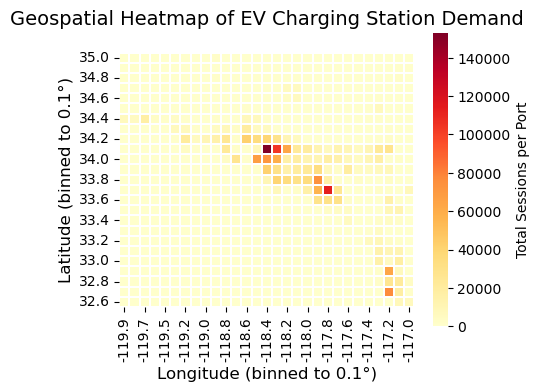

In [75]:
df_heatmap = df.copy()

#Remove outliers
df_heatmap = df_heatmap[
    (df_heatmap['LATITUDE'].between(32, 35)) &   
    (df_heatmap['LONGITUDE'].between(-120, -117))
]

df_heatmap['lat_bin'] = df_heatmap['LATITUDE'].round(1)
df_heatmap['lon_bin'] = df_heatmap['LONGITUDE'].round(1)

geo_group = (
    df_heatmap
    .groupby(['lat_bin', 'lon_bin'], as_index=False)['sessions_per_port']
    .sum() )

pivot_table = geo_group.pivot(index='lat_bin', columns='lon_bin', values='sessions_per_port')

pivot_table = pivot_table.fillna(0)

# Plot
plt.figure(figsize=(5, 4))
ax = sns.heatmap(
    pivot_table,
    cmap='YlOrRd',          
    cbar_kws={'label': 'Total Sessions per Port'},
    linewidths=0.01,        
    square=True             
)

ax.set_xlabel("Longitude (binned to 0.1°)", fontsize=12)
ax.set_ylabel("Latitude (binned to 0.1°)", fontsize=12)
plt.title("Geospatial Heatmap of EV Charging Station Demand", fontsize=14, pad=20)

ax.invert_yaxis()

plt.tight_layout()
plt.show()

In [10]:
import plotly.express as px

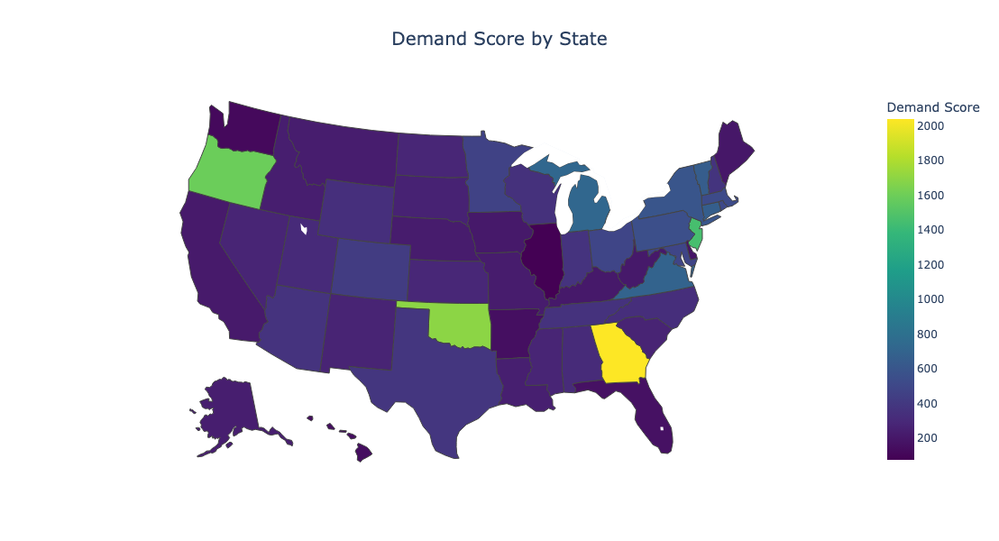

In [11]:
state_demand = df.groupby('STATE')['demand_score'].mean().reset_index()
fig = px.choropleth(
    state_demand,
    locations='STATE',
    locationmode='USA-states',
    color='demand_score',
    scope='usa',
    title='Demand Score by State',
    color_continuous_scale='Viridis',
    labels={'demand_score': 'Demand Score'}
)

fig.update_layout(
    width=1000,
    height=600,
    title_x=0.5,  # Center the title
    title_font_size=20
)


fig.show()

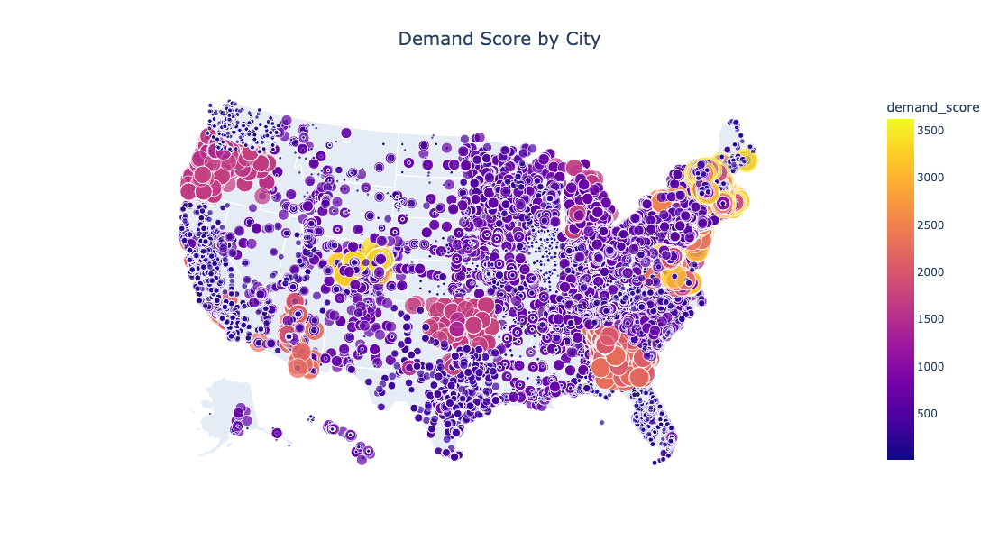

In [12]:
fig = px.scatter_geo(
    df,
    lat='LATITUDE',
    lon='LONGITUDE',
    color='demand_score',
    size='demand_score',  # Marker size = demand_score
    #hover_name='CITY',
    #hover_data=['STATION_NAME', 'STATE'],
    scope='usa',
    title='Demand Score by City',
    color_continuous_scale='Plasma'
)

# Make the plot larger
fig.update_layout(
    width=1000,
    height=600,
    title_x=0.5,  # Center the title
    title_font_size=20
)

fig.show()